In [5]:
library(ggplot2)
library(RColorBrewer)
library(cowplot)


********************************************************
Note: As of version 1.0.0, cowplot does not change the
  default ggplot2 theme anymore. To recover the previous
  behavior, execute:
  theme_set(theme_cowplot())
********************************************************



In [6]:
beta_dir = "/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/May2021/genetic_effect/MOFA10/"

In [7]:
flips_filename = paste0(beta_dir, "eqtl_with_flip_sign.csv")
flips_df = read.csv(flips_filename, row.names = 1)
head(flips_df,2)

,beta_G,n,gene,snp_id
ABHD12B-14_51328222_C_T,-0.10783378,0.2393439,ABHD12B,14_51328222_C_T
ADSL-22_40757228_A_C,0.09485572,0.6827107,ADSL,22_40757228_A_C


In [8]:
## load single-cell eQTL genetic effects due to GxC (beta_GxC)
df = read.csv(paste0(beta_dir,"eqtl_tot_genetic_effect_all.txt"), sep="\t",row.names = 1)
colnames(df) = gsub("_-","-",gsub("\\.","-",colnames(df)))
head(df,2)
nrow(df)
ncol(df)

,ABHD10-3_111697439_T_G,ABHD12B-14_51328222_C_T,ACKR2-3_42817129_C_T,ADD2-2_70894426_A_T,ADSL-22_40757228_A_C,AIM1L-1_26673825_C_T,AKAP7-6_131691964_C_A,ALDH7A1-5_126011412_G_A,ANKRD18B-9_33524775_C_A,APIP-11_34905987_T_C,...,YWHAE-17_1246420_G_A,ZBBX-3_167080934_T_G,ZC3HAV1-7_138730361_T_C,ZFR2-19_3840157_C_T,ZG16B-16_2871121_T_C,ZNF423-16_49599995_C_G,ZNF552-19_58315273_G_A,ZNF738-19_21474173_G_A,ZNF77-19_2936535_G_A,ZP3-7_76177284_C_T
HPSI0714i-iudw_1--DA--d30--0,-0.2108622,0.003924475,0.02206444,0.02834211,0.2235163,-0.03575032,-0.09473256,0.006901295,0.0006737957,-0.07499119,...,0.06962421,0.1120253,-0.04172133,0.01126897,0.1057579,-0.03101814,0.0909417,0.3020245,-0.1583842,-0.05596878
HPSI0714i-iudw_1--DA--d30--1,-0.2283969,-0.047217741,0.10596178,0.02514689,-0.1921801,-0.01471768,0.01878961,-0.171038975,-0.1105473675,-0.18686595,...,-0.21070417,0.3759854,0.08774666,0.02505916,-0.1950055,-0.22780547,0.0775938,0.3452492,-0.3472152,-0.15259400


[1] 8352

[1] 213

In [9]:
df_pcs = read.csv("/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/May2021/mofa_tsne.csv", row.names=1)

In [10]:
head(df_pcs,2)

,tSNE1,tSNE2,condition
HPSI0714i-iudw_1--DA--d30--0,-13.756691,32.71191,d30
HPSI0714i-iudw_1--DA--d30--1,4.620292,31.43719,d30


In [11]:
cells0 = rownames(df)
df_pcs = df_pcs[cells0,]

In [12]:
# load persistent genetic effects (shared across all cells, beta_G)
df0 = read.csv(paste0(beta_dir,"eqtl_persistent_genetic_effect_all.txt"), sep="\t",row.names = 1)
rownames(df0) = gsub("\\.","-",rownames(df0))
head(df0)
nrow(df0)

,beta_G
ABHD10-3_111697439_T_G,0.30340827
ABHD12B-14_51328222_C_T,-0.10783378
ACKR2-3_42817129_C_T,-0.09692314
ADD2-2_70894426_A_T,-0.14525581
ADSL-22_40757228_A_C,0.09485572
AIM1L-1_26673825_C_T,0.04175069


[1] 213

In [13]:
df1 = df[,colnames(df) %in% gsub("\\.","-",rownames(flips_df))]
genes = colnames(df1)
# genes = genes[19]
length(genes)
# genes

[1] 94

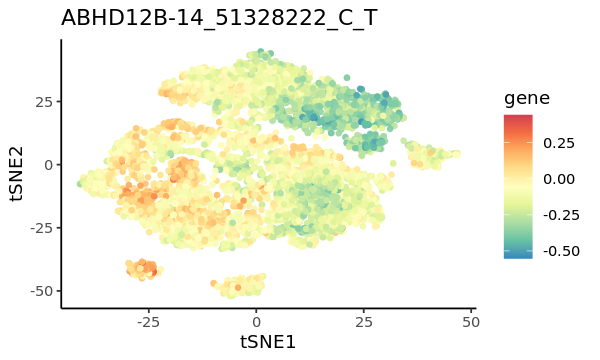

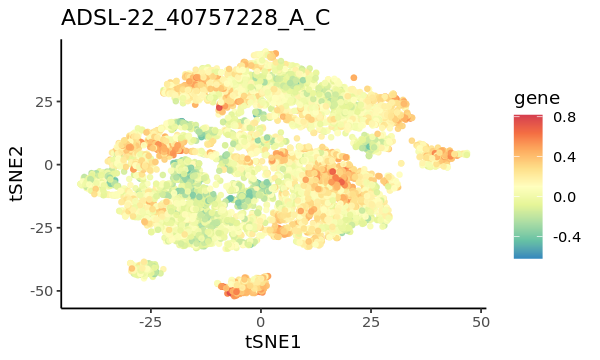

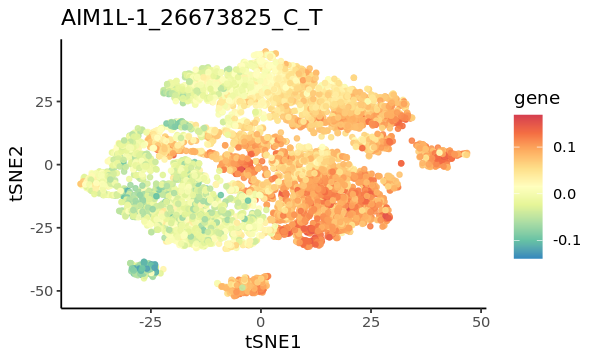

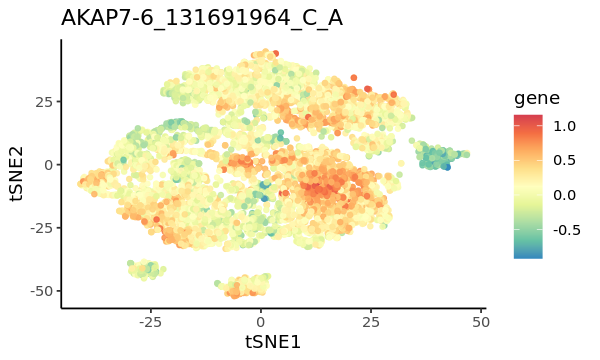

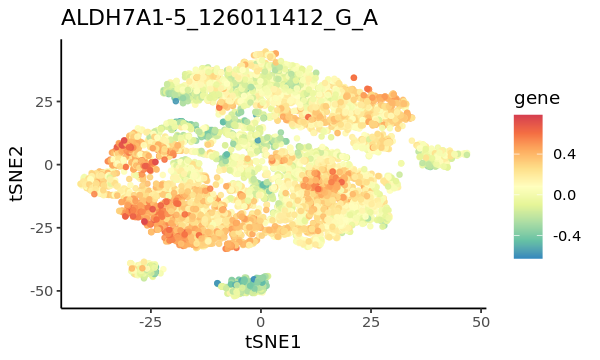

...

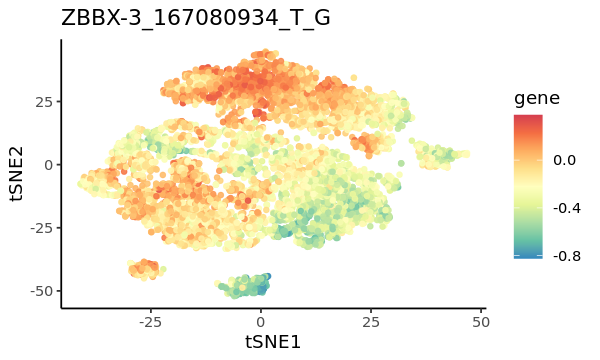

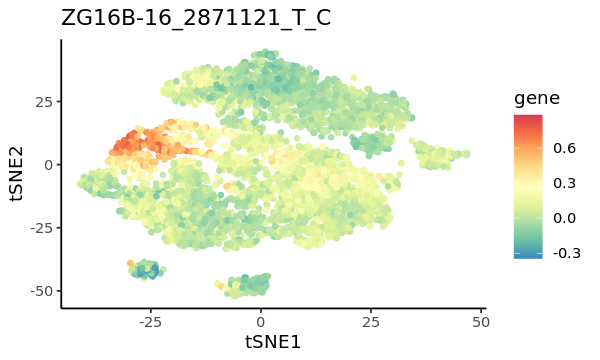

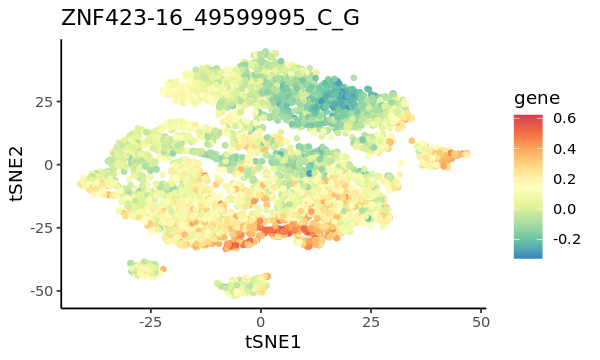

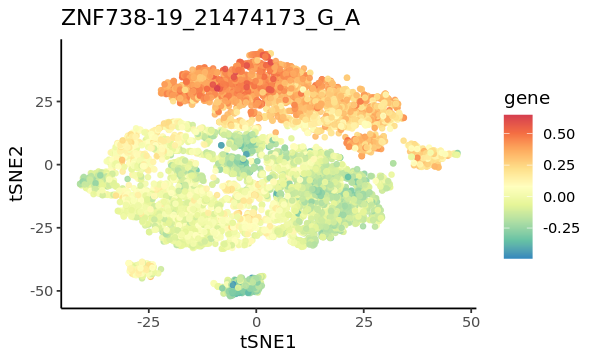

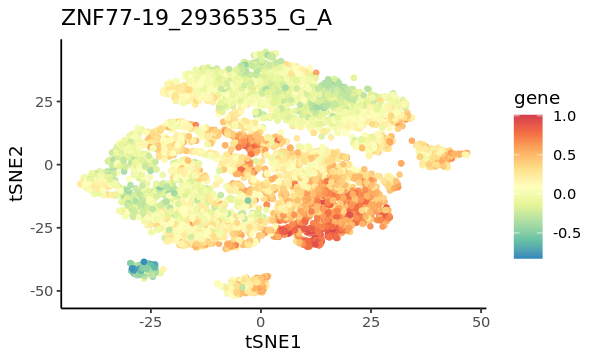

In [17]:
options(repr.plot.width = 5, repr.plot.height = 3)
for (gene in genes){
    df_to_plot0 = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df0[gene,]+df1[,gene]))
    p = ggplot(df_to_plot0, aes(x = tSNE1, y = tSNE2, col = gene)) + geom_point(alpha = 0.9, size = 1.2) 
    p = p + ggtitle(gene)
    p = p + theme_classic() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

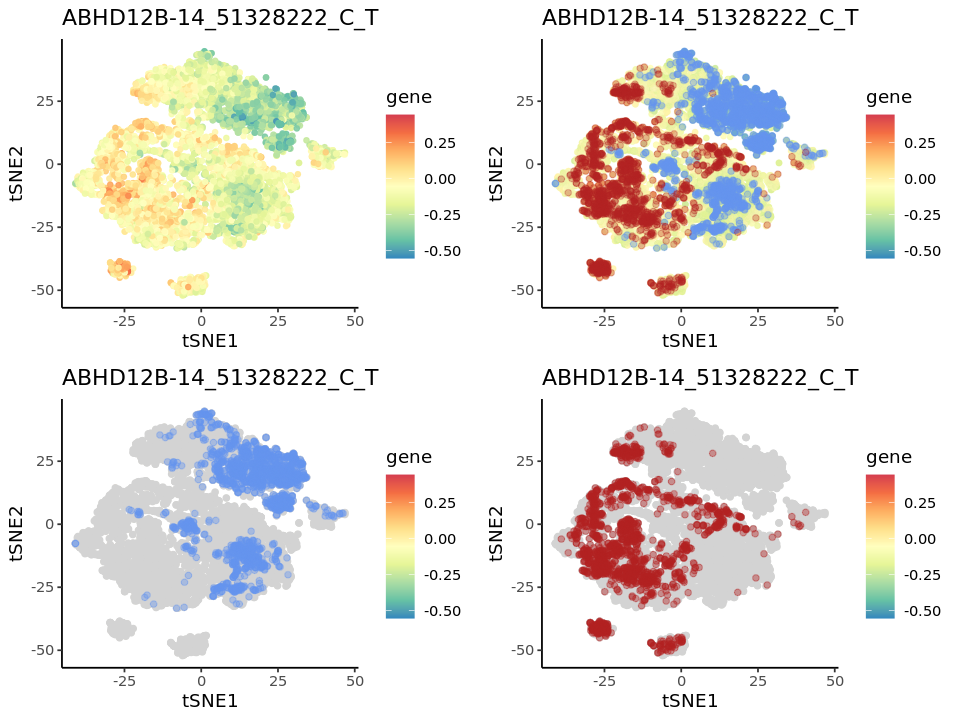

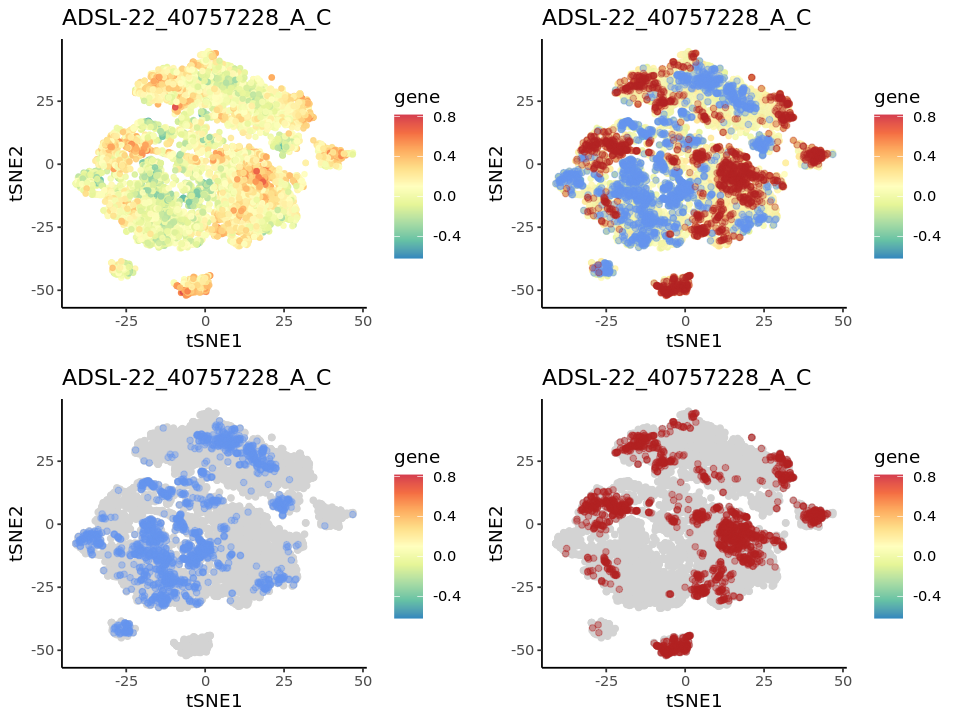

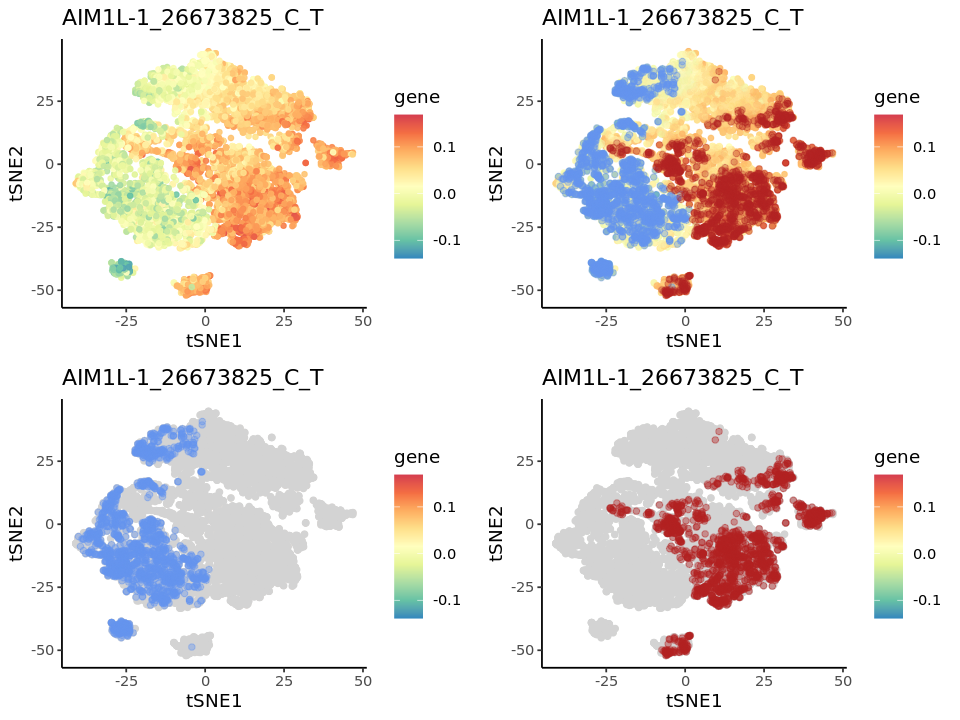

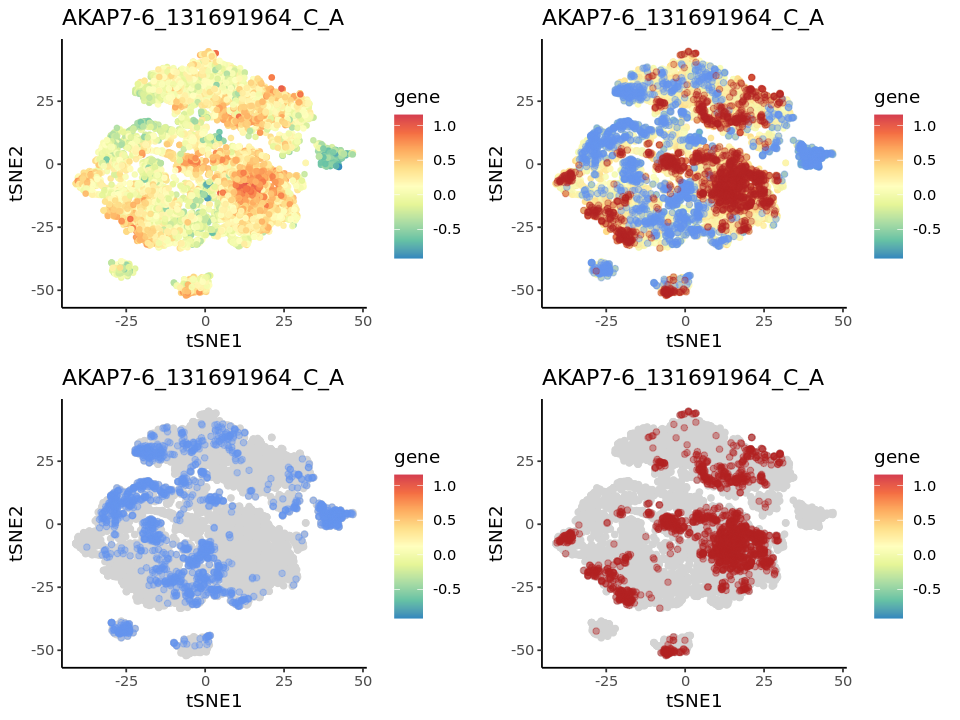

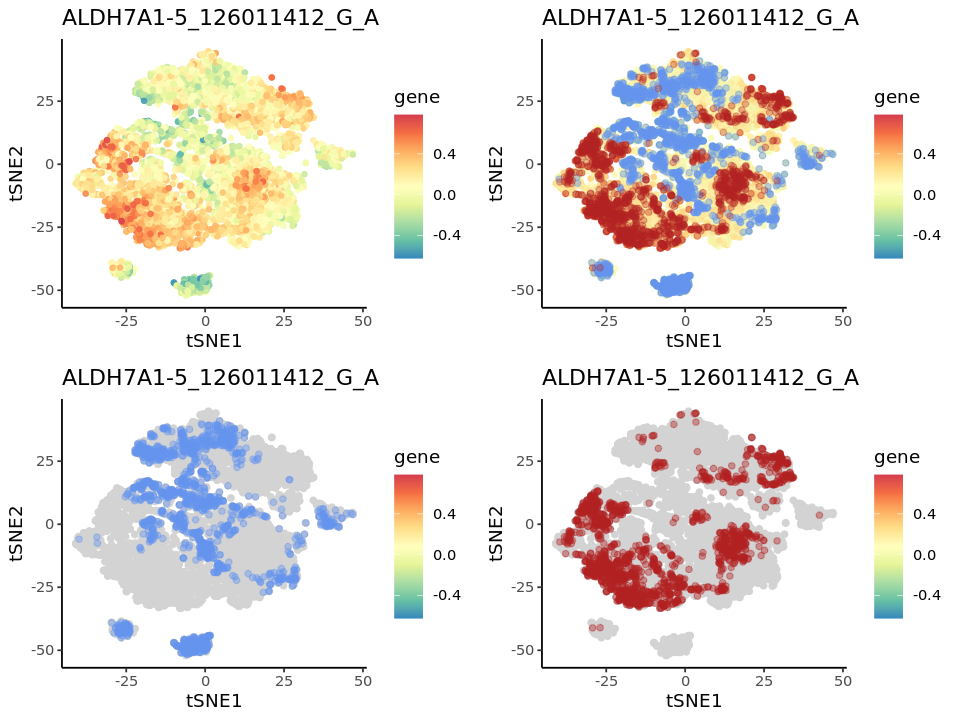

...

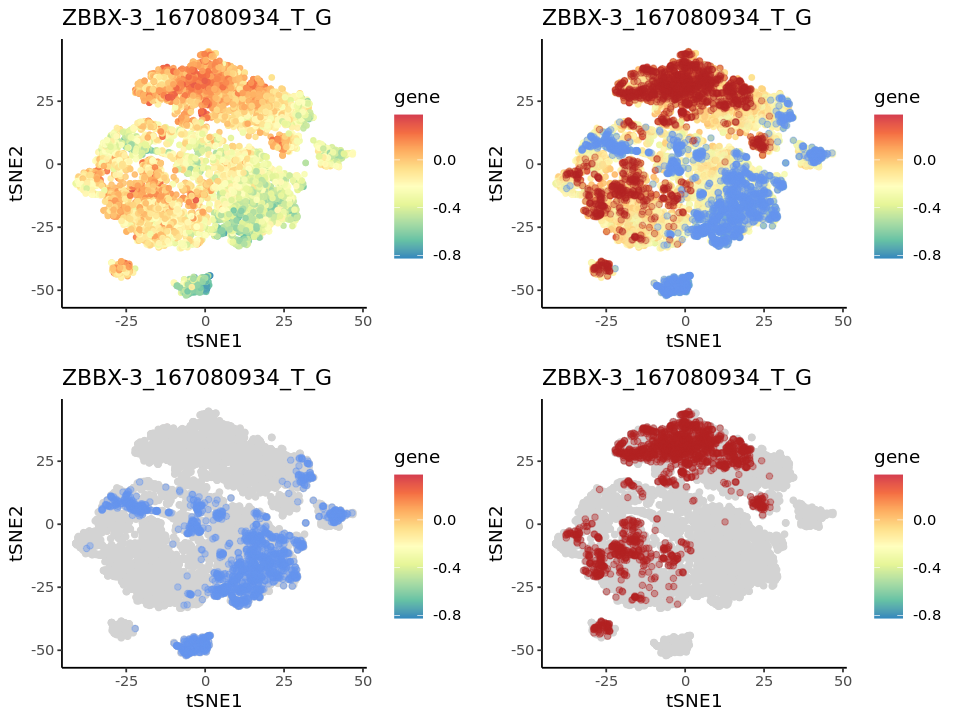

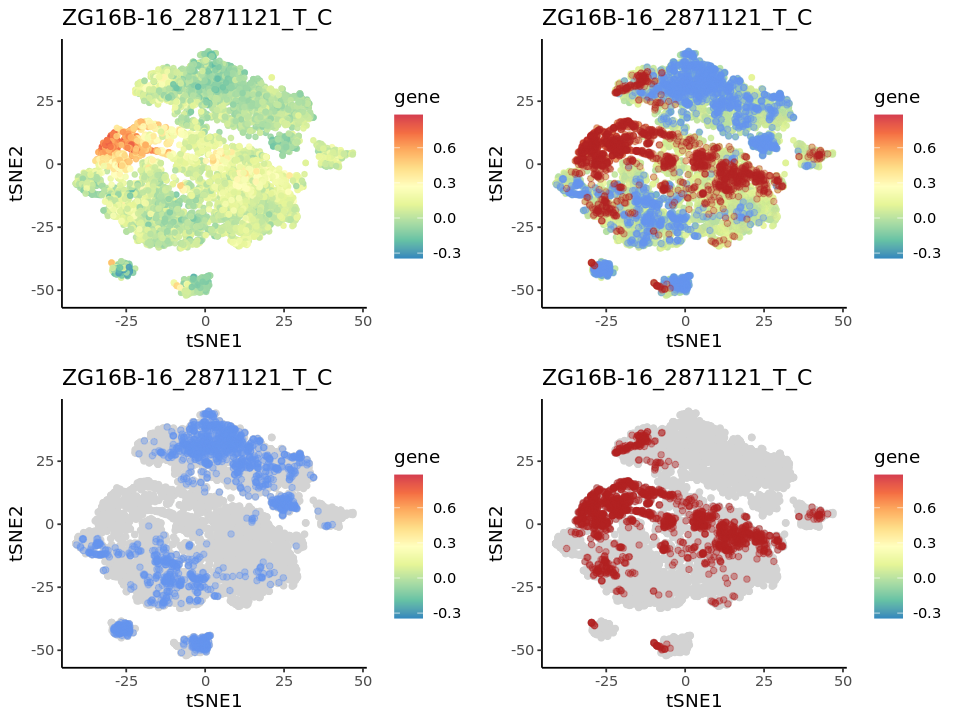

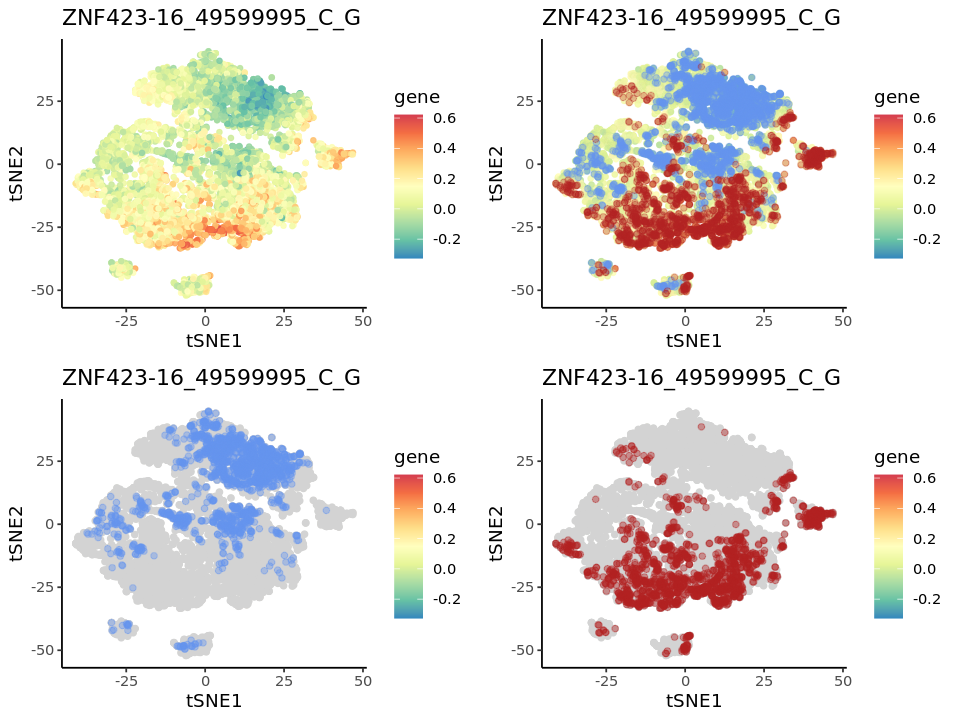

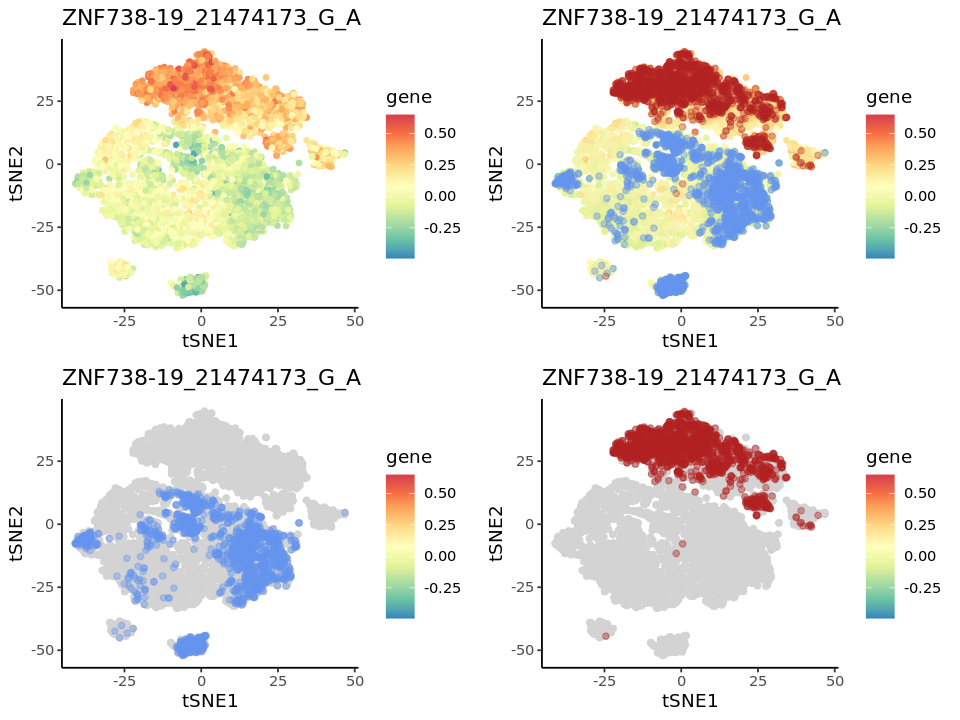

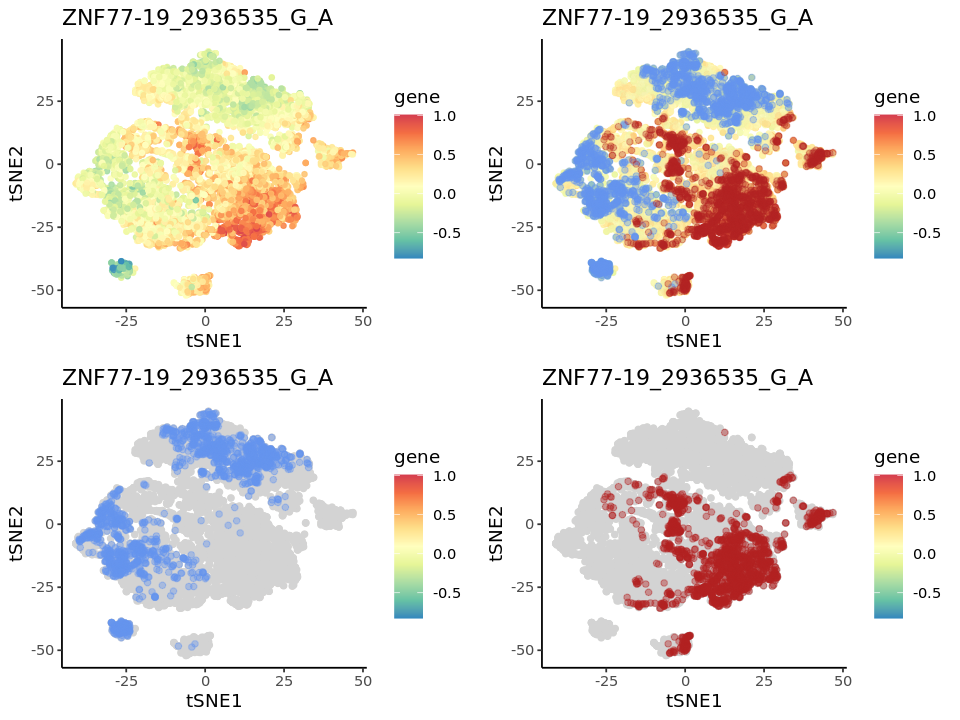

In [41]:
options(repr.plot.width = 8, repr.plot.height = 6)
for (gene in genes){
    df_to_plot0 = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df0[gene,]+df1[,gene]))
    p = ggplot(df_to_plot0, aes(x = tSNE1, y = tSNE2, col = gene)) + geom_point(alpha = 0.9, size = 1.2) 
    p = p + ggtitle(gene)
    p = p + theme_classic() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    
    qts = quantile(df_to_plot0$gene, probs = c(0.2, 0.8))
    bottom_pseudocells = rownames(df_to_plot0[df_to_plot0$gene < qts[1],])
    top_pseudocells = rownames(df_to_plot0[df_to_plot0$gene > qts[2],])

    p0 = p + geom_point(alpha = 0.05) 
    p0 = p0 + geom_point(col="cornflowerblue", alpha = 0.4, data = df_to_plot0[bottom_pseudocells,])
    p0 = p0 + geom_point(col="firebrick", alpha = 0.3, data = df_to_plot0[top_pseudocells,])
    
    p1 = p + geom_point(col="lightgrey") 
    p1 = p1 + geom_point(col="cornflowerblue", alpha = 0.4, data = df_to_plot0[bottom_pseudocells,])
    
    p2 = p + geom_point(col="lightgrey") 
    p2 = p2 + geom_point(col="firebrick", alpha = 0.4, data = df_to_plot0[top_pseudocells,]) 
    
    print(plot_grid(p, p0, p1, p2, ncol=2))
    
}

In [42]:
##### save pseudocells

In [18]:
for (gene in genes){
    df_to_plot0 = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df0[gene,]+df1[,gene]))
    qts = quantile(df_to_plot0$gene, probs = c(0.2, 0.8))
    # top 20%
    top_pseudocells = rownames(df_to_plot0[df_to_plot0$gene > qts[2],])
    dft = data.frame(gene = top_pseudocells)
    colnames(dft) = gene
    myfile_top = paste0(beta_dir,"flip_signs/",gene,"_top20quantile_pseudocells.csv")
    write.csv(dft, myfile_top)
    # bottom 20%
    bottom_pseudocells = rownames(df_to_plot0[df_to_plot0$gene < qts[1],])
    dfb = data.frame(gene = bottom_pseudocells)
    colnames(dfb) = gene
    myfile_bottom = paste0(beta_dir,"flip_signs/",gene,"_bottom20quantile_pseudocells.csv")
    write.csv(dfb, myfile_bottom)
}

In [19]:
nrow(dft)
nrow(dfb)

[1] 1671

[1] 1671

In [20]:
head(dft)

ZNF77-19_2936535_G_A
HPSI0115i-paim_1--DA--d30--38
HPSI0114i-eipl_1--DA--d30--5
HPSI0614i-uevq_6--DA--d30--15
HPSI1014i-quls_2--DA--d30--1
HPSI1014i-quls_2--DA--d30--4
HPSI1014i-quls_2--DA--d30--7


In [21]:
head(dfb)

ZNF77-19_2936535_G_A
HPSI0714i-iudw_1--DA--d30--1
HPSI0714i-iudw_1--DA--d30--2
HPSI0714i-iudw_1--DA--d30--3
HPSI0714i-iudw_1--DA--d30--7
HPSI0714i-iudw_1--DA--d30--8
HPSI0714i-iudw_1--DA--d30--13


In [46]:
#### get cells from pseudocells

In [22]:
df_obs = read.csv("/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/adata_obs_pseudocells_DA.csv", row.names=1)
df_obs$pseudocell = paste0(df_obs$donor_id,"--",df_obs$celltype,"--",df_obs$Condition,"--",df_obs$leiden_res_34_euclidean)

In [23]:
nrow(df_obs)
head(df_obs,2)

[1] 8648

donor_id         celltype time_point treatment Condition
0 HPSI0714i-iudw_1 DA       D30        NONE      d30      
1 HPSI0714i-iudw_1 DA       D30        NONE      d30      
  leiden_res_34_euclidean Number_of_cells
0 0                       26             
1 1                       25             
  cell_ids                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

In [24]:
flip_folder = "/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/May2021/genetic_effect/MOFA10/flip_signs/"

In [25]:
top_files = paste0(flip_folder,list.files(flip_folder,"top20quantile_pseudocells.csv"))
length(top_files)
head(top_files,2)

[1] 94

[1] "/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/May2021/genetic_effect/MOFA10/flip_signs/ABHD12B-14_51328222_C_T_top20quantile_pseudocells.csv"
[2] "/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/May2021/genetic_effect/MOFA10/flip_signs/ADSL-22_40757228_A_C_top20quantile_pseudocells.csv"

In [26]:
for (myfile_top in top_files){
    file_map_top = gsub("pseudocells","pseudocell_cell_map",myfile_top)
    df = read.csv(myfile_top, row.names=1)
    df_cell_to_pseudocell = data.frame()
    for (i in 1:nrow(df)){
        pseudocell = as.character(df[i,])
        df_obs_sel = df_obs[df_obs$pseudocell == pseudocell,]
        if (nrow(df_obs_sel)==0){next}
        cells = gsub(" ","",gsub("_d.*","",gsub("\\'","",gsub("\\[","",unlist(strsplit(as.character(df_obs_sel$cell_ids),","))))))
        df_curr = data.frame(pseudocell = pseudocell, cell = gsub(" ","",cells))
        df_cell_to_pseudocell = rbind(df_cell_to_pseudocell, df_curr)
    }
    write.csv(df_cell_to_pseudocell, file_map_top)
}

In [27]:
bottom_files = paste0(flip_folder,list.files(flip_folder,"bottom20quantile_pseudocells.csv"))
length(bottom_files)
head(bottom_files,2)

[1] 94

[1] "/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/May2021/genetic_effect/MOFA10/flip_signs/ABHD12B-14_51328222_C_T_bottom20quantile_pseudocells.csv"
[2] "/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/May2021/genetic_effect/MOFA10/flip_signs/ADSL-22_40757228_A_C_bottom20quantile_pseudocells.csv"

In [28]:
for (myfile_bottom in bottom_files){
    file_map_bottom = gsub("pseudocells","pseudocell_cell_map",myfile_bottom)
    df = read.csv(myfile_bottom, row.names=1)
    df_cell_to_pseudocell = data.frame()
    for (i in 1:nrow(df)){
        pseudocell = as.character(df[i,])
        df_obs_sel = df_obs[df_obs$pseudocell == pseudocell,]
        if (nrow(df_obs_sel)==0){next}
        cells = gsub("_d.*","",gsub("\\'","",gsub("\\[","",unlist(strsplit(as.character(df_obs_sel$cell_ids),",")))))
        df_curr = data.frame(pseudocell = pseudocell, cell = gsub(" ","",cells))
        df_cell_to_pseudocell = rbind(df_cell_to_pseudocell, df_curr)
    }
    write.csv(df_cell_to_pseudocell, file_map_bottom)
}

In [3]:
length(list.files(flip_folder,"bottom20quantile_pseudocell_cell_map.csv"))

[1] 94

In [4]:
length(list.files(flip_folder,"top20quantile_pseudocell_cell_map.csv"))

[1] 94

In [ ]:
########### this is after running standard eQTL mapping separately using the top and bottom cell populations

In [10]:
options(repr.plot.width = 5, repr.plot.height = 3)

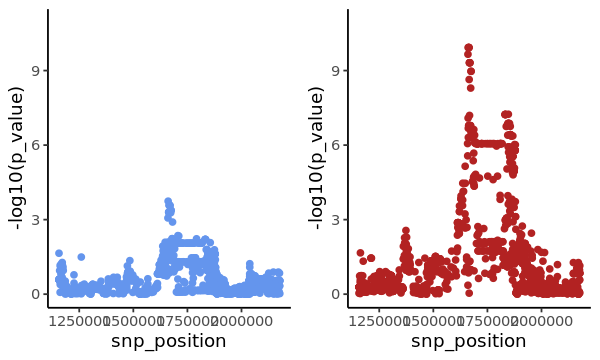

In [11]:
mydir = "/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/da_coloc_GxC/"
mydirtop = paste0(mydir, "input_files_SLC35E2-1_1660978_C_A_top30quantile_d52/")
filename_top = paste0(mydirtop,"results/qtl_results_all.txt")
mydirbottom = paste0(mydir, "input_files_SLC35E2-1_1660978_C_A_bottom30quantile_d52/")
filename_bottom = paste0(mydirbottom,"/results/qtl_results_all.txt")
df_top = read.csv(filename_top,sep="\t")
df_to_plot1 = df_top
m1 = min(df_to_plot1$p_value)
df_bottom = read.csv(filename_bottom,sep="\t")
df_to_plot2 = df_bottom
m2 = min(df_to_plot2$p_value)
m = -log10(min(m1,m2))+1
p_top = ggplot(df_to_plot1, aes(x=snp_position,y=-log10(p_value))) + geom_point(col="cornflowerblue") + theme_classic() + ylim(c(0,m))
p_bottom = ggplot(df_to_plot2, aes(x=snp_position,y=-log10(p_value))) + geom_point(col="firebrick") + theme_classic() + ylim(c(0,m))
# p_top = p_top + ggtitle(gsub("quantile","",gsub("input_files_","",myfiles[2])))
# p_bottom = p_bottom + ggtitle(gsub("quantile","",gsub("input_files_","",myfiles[1])))
plot_grid(p_top, p_bottom, ncol=2)

In [2]:
df_gwas_filename = "/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/gwas_insomnia_awith_pos.csv"
df_gwas = read.csv(df_gwas_filename, row.names=1)
head(df_gwas)

,variant,minor_allele,minor_AF,expected_min_category_minor_AC,low_confidence_variant,n_complete_samples,AC,ytx,beta,se,tstat,pval,pos,chr
0,1:15791:C:T,T,5.43548e-09,4.95716e-06,True,360738,3.92157e-03,7.84314e-03,21.65330000,1.81002e+02,0.119630,0.9047760,15791,1
1,1:69487:G:A,A,5.75617e-06,5.24963e-03,True,360738,4.15294e+00,7.29804e+00,-0.30861000,3.54539e-01,-0.870454,0.3840530,69487,1
2,1:69569:T:C,C,1.87959e-04,1.71419e-01,True,360738,1.35608e+02,2.81702e+02,0.03901000,6.35850e-02,0.613510,0.5395400,69569,1
3,1:139853:C:T,T,5.66921e-06,5.17032e-03,True,360738,4.09020e+00,7.18039e+00,-0.30638500,3.54550e-01,-0.864151,0.3875050,139853,1
4,1:692794:CA:C,C,1.10645e-01,1.00908e+02,False,360738,7.98278e+04,1.62827e+05,-0.00532662,2.93859e-03,-1.812640,0.0698875,692794,1
5,1:693731:A:G,G,1.15844e-01,1.05649e+02,False,360738,8.35783e+04,1.70469e+05,-0.00509511,2.77643e-03,-1.835130,0.0664873,693731,1


In [3]:
nrow(df_gwas)
df_gwas_common = df_gwas[df_gwas$minor_AF > 0.05,]
nrow(df_gwas_common)

[1] 13791467

[1] 6949336

In [4]:
df_gwas_common_chr10 = df_gwas_common[df_gwas_common$chr == "10",]

In [7]:
pos1 = min(df_to_plot2$snp_position)
pos2 = max(df_to_plot2$snp_position)

Warning message:
“Removed 6892932 rows containing missing values (geom_point).”

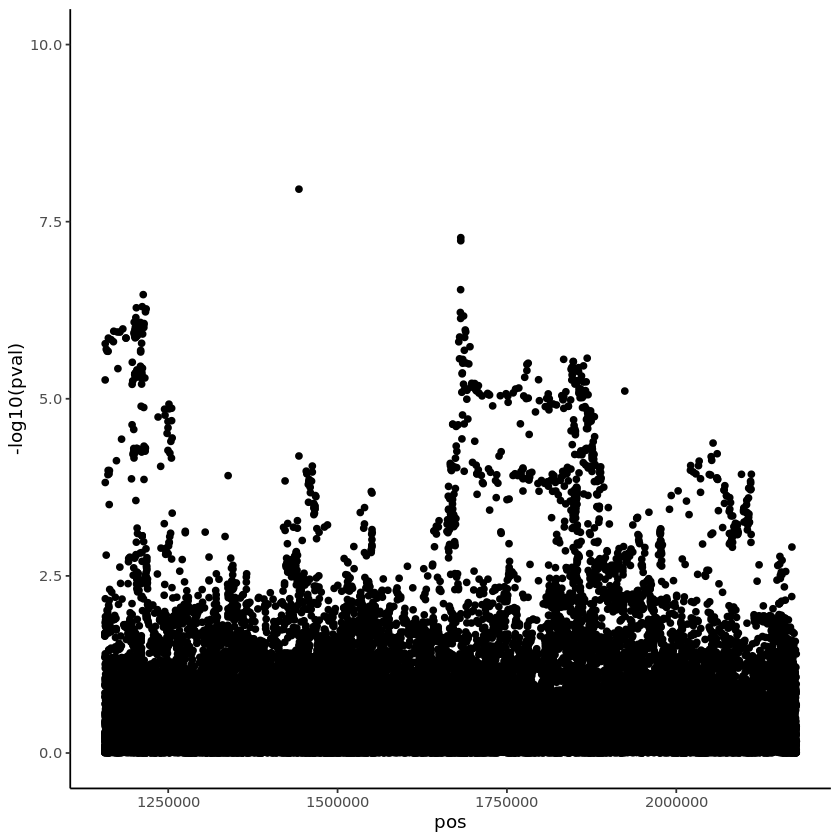

In [9]:
ggplot(df_gwas_common, aes(x=pos,y=-log10(pval))) + geom_point() + theme_classic() + xlim(c(pos1,pos2)) + ylim(c(0,10))

In [52]:
df_bottom[df_bottom$snp_id == "1_1660978_C_A",]

feature_id,snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,alpha_param,beta_param,rho,snp_chromosome,snp_position,assessed_allele,call_rate,maf,hwe_p
ENSG00000215790,1_1660978_C_A,1.187926e-10,0.4974951,0.0772404,3.021966e-05,1,1656277,1677431,141,141,0.5800896,111.8357,0.1,1,1660978,A,1,0.4007092,0.2917316


In [53]:
df_top[df_top$snp_id == "1_1660978_C_A",]

feature_id,snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,alpha_param,beta_param,rho,snp_chromosome,snp_position,assessed_allele,call_rate,maf,hwe_p
ENSG00000215790,1_1660978_C_A,0.0001805518,0.3261731,0.08710072,0.07845947,1,1656277,1677431,138,138,0.6395695,88.62756,0.1,1,1660978,A,1,0.4021739,0.5955691


In [54]:
-log10(1.187926e-10)

[1] 9.925211